## Домашнее задание 3. Выбор и обучение модели на отобранных признаках. Сравнение качества и оценка модели

In [1]:
import pandas as pd
import numpy as np
import xgboost as xgb
from matplotlib import pyplot as plt
import warnings
warnings.filterwarnings("ignore")

from scipy import interp
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.feature_selection import chi2, mutual_info_classif, RFECV
from sklearn.metrics import precision_score, recall_score, f1_score, precision_recall_curve, roc_curve, auc, \
                            log_loss, roc_auc_score, average_precision_score, confusion_matrix

def evaluation(y_true, y_pred, y_prob):
    precision = precision_score(y_true=y_true, y_pred=y_pred)
    recall = recall_score(y_true=y_true, y_pred=y_pred)
    f1 = f1_score(y_true=y_true, y_pred=y_pred)
    ll = log_loss(y_true=y_true, y_pred=y_prob)
    roc_auc = roc_auc_score(y_true=y_true, y_score=y_prob)
    print('Precision: {}'.format(precision))
    print('Recall: {}'.format(recall))
    print('F1: {}'.format(f1))
    print('Log Loss: {}'.format(ll)) 
    print('ROC AUC: {}'.format(roc_auc)) 
    return precision, recall, f1, ll, roc_auc

def xgb_fit_predict(X_train, y_train, X_test, y_test):
    clf = xgb.XGBClassifier(max_depth=3,
                            n_estimators=100,
                            learning_rate=0.1,
                            nthread=5,
                            subsample=1.,
                            colsample_bytree=0.5,
                            min_child_weight = 3,
                            reg_alpha=0.,
                            reg_lambda=0.,
                            seed=42,
                            missing=1e10)

    clf.fit(X_train, y_train, eval_metric='aucpr', verbose=10)
    predict_proba_test = clf.predict_proba(X_test)
    predict_test = clf.predict(X_test)
    precision_test, recall_test, f1_test, log_loss_test, roc_auc_test = \
        evaluation(y_test, predict_test, predict_proba_test[:, 1])
    return clf

def plot_importance(importance, features, name):
    fi = pd.DataFrame(list(zip(features, importance))).sort_values(by=1, ascending=False)
    plt.figure(figsize=(16,6))
    plt.bar(range(fi.shape[0]), fi[1], align='center')
    plt.xticks(range(fi.shape[0]), fi[0], rotation=90)
    plt.title(name)
    plt.show()
    return fi

In [2]:
%%time
dataset = pd.read_csv('dataset/dataset_train.csv', sep=';')
X = dataset.drop(['user_id', 'is_churned'], axis=1)
y = dataset['is_churned']

X_mm = MinMaxScaler().fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_mm, 
                                                    y, 
                                                    test_size=0.3,
                                                    shuffle=True, 
                                                    stratify=y, 
                                                    random_state=100)

# Снизим дизбаланс классов
X_train_balanced, y_train_balanced = SMOTE(random_state=42, ratio=0.3).fit_sample(X_train, y_train)

Wall time: 25.8 s


#### 1. Используя признаки, отобранные взаимной информацией, RFE и PI, посмотрите качество XGBoost'а по аналогии с тем, как это делалось на уроке. При каком подходе к отбору признаков получается лучшее значение F1?

### RFE (Recursive Feature Elimination)

Рекурскивный отсев признаков - убираем на каждой итерации самые слабые признаки и делаем это до тех пор, пока не увидим заметного снижения качества. На каком кол-ве признаков остановимся, то и считаем оптимальным.

In [3]:
%%time
STEP = 5
logit = LogisticRegression(random_state=42)

selector = RFECV(estimator=logit, step=STEP, cv=StratifiedKFold(2), scoring='f1')
selector.fit(X_train_balanced, y_train_balanced)

good_features = X.columns[selector.support_]
print("Optimal number of features : %d" % selector.n_features_)

Optimal number of features : 60
Wall time: 1min 19s


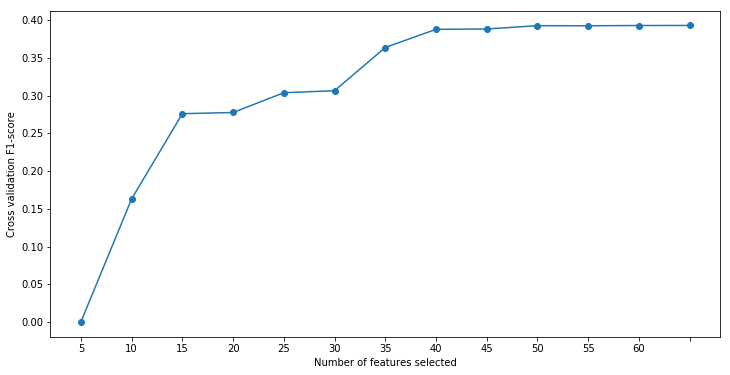

In [4]:
plt.figure(figsize=(12,6))
plt.plot(range(1, len(selector.grid_scores_) + 1), selector.grid_scores_, 'o-')
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation F1-score")
plt.xticks(range(1, len(selector.grid_scores_) + 1), reversed(list(range(X_train.shape[1], 1, -STEP))))
plt.show()

In [6]:
X_train_RFE = pd.DataFrame(X_train_balanced, columns=X.columns)[good_features[:40]]
X_test_RFE = pd.DataFrame(X_test, columns=X.columns)[good_features[:40]]

fitted_clf = xgb_fit_predict(X_train_RFE, y_train_balanced, X_test_RFE, y_test)

print('Признаков было:', X_train.shape[1])
print('Признаков стало:', X_train_RFE.shape[1])

Precision: 0.29260089686098656
Recall: 0.4404532304725169
F1: 0.35161662817551964
Log Loss: 0.13391951151394105
ROC AUC: 0.8979420261897628
Признаков было: 60
Признаков стало: 40


### Permutation Importance (PI)

Перемешивание значений столбца важного признака приводит к заметному снижению качества работы модели

In [7]:
from ELI5 import PermutationImportance

In [8]:
%%time
fitted_clf = xgb_fit_predict(X_train_balanced, y_train_balanced, X_test, y_test)
perm = PermutationImportance(fitted_clf, random_state=42).fit(X_train_balanced, y_train_balanced)

res = pd.DataFrame(X.columns, columns=['feature'])
res['score'] = perm.feature_importances_
res['std'] = perm.feature_importances_std_
res = res.sort_values(by='score', ascending=False).reset_index(drop=True)

Precision: 0.2868865911701953
Recall: 0.4214079074252652
F1: 0.3413729128014843
Log Loss: 0.13458398834453714
ROC AUC: 0.8987204592518738
Wall time: 5min 13s


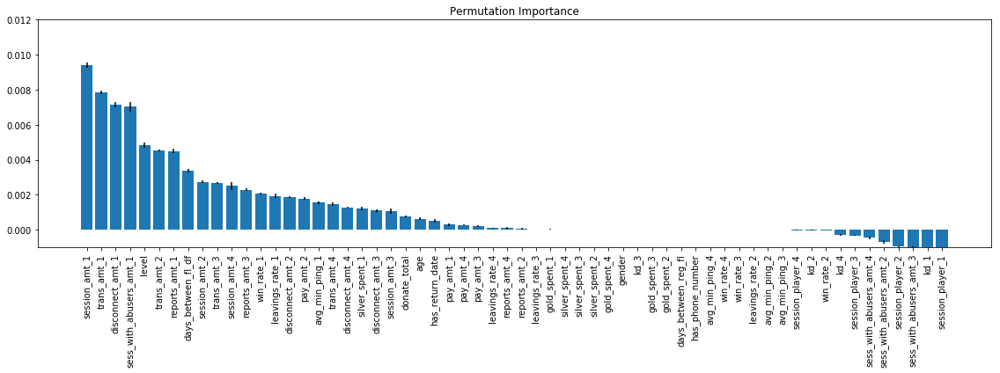

In [9]:
plt.figure(figsize=(16,6))
plt.bar(range(res.shape[0]), res['score'], yerr=res['std'], align='center')
plt.xticks(range(res.shape[0]), res['feature'], rotation=90)
plt.title('Permutation Importance')
plt.tight_layout()
plt.ylim(-0.001,0.012)
plt.show()

In [10]:
good_features = res.loc[res['score'] > 0]['feature']
print('Кол-во отобранных признаков:', good_features.shape[0])

Кол-во отобранных признаков: 35


In [11]:
X_train_PI = pd.DataFrame(X_train_balanced, columns=X.columns)[good_features]
X_test_PI = pd.DataFrame(X_test, columns=X.columns)[good_features]

fitted_clf = xgb_fit_predict(X_train_PI, y_train_balanced, X_test_PI, y_test)

print('Признаков было:', X_train.shape[1])
print('Признаков стало:', X_train_PI.shape[1])

Precision: 0.2847079037800687
Recall: 0.39946962391513985
F1: 0.33246388443017655
Log Loss: 0.13547935743104297
ROC AUC: 0.8958863521591102
Признаков было: 60
Признаков стало: 35


## Оценка качества модели

В качестве базового решения у нас модель XGBoost, которую мы обучили в начале урока. Проведем ее более комплексную оценку, для этого напишем несколько вспомогательных фукнций для более наглядной визуализации результатов.

In [12]:
def plot_confusion_matrix(y_true, y_pred, classes, cmap=plt.cm.Blues):
    TN, FP, FN, TP = confusion_matrix(y_true, y_pred).ravel()
    cm = np.array([[TP, FP],
                   [FN, TN]])
    cm_normalized = cm.astype('float') / cm.sum(axis=0)
    # Plot both matrixes - basic and normalized
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,10))
    for ax, normalize, data, title in zip(ax,
                                          [False, True], 
                                          [cm, cm_normalized], 
                                          ['Confusion matrix (without normalization)', 
                                           'Сonfusion matrix (normalized)']):
        im = ax.imshow(data, interpolation='nearest', cmap=cmap)
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im, cax=cax)
        ax.set(xticks=np.arange(data.shape[1]),
               yticks=np.arange(data.shape[0]),
               xticklabels=classes, 
               yticklabels=classes,
               title=title,
               ylabel='Predicted label',
               xlabel='True label')
        plt.setp(ax.get_xticklabels(), rotation=45, ha='right', rotation_mode='anchor')        
        # Loop over data dimensions and create text annotations
        fmt = '.2f' if normalize else 'd'
        for i in range(data.shape[0]):
            for j in range(data.shape[1]):
                ax.text(j, i, format(data[i, j], fmt), ha="center", va="center", 
                        color="white" if data[i, j] > data.max() / 2. else "black")                
    fig.tight_layout()
    return fig 

def plot_PR_curve(y_true, y_pred, y_prob):
    AP = average_precision_score(y_true=y_true, y_score=y_prob)
    precisions, recalls, thresholds = precision_recall_curve(y_true=y_true, probas_pred=y_prob)
    
    plt.step(recalls, precisions, color='b', alpha=0.2, where='post')
    plt.fill_between(recalls, precisions, alpha=0.2, color='b', step='post')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title('PR curve: AP={0:0.2f}'.format(AP))
    
def plot_ROC_curve(classifier, X, y, n_folds):
    
    cv = StratifiedKFold(n_splits=n_folds)
    tprs = []
    aucs = []
    mean_fpr = np.linspace(0, 1, 100)
    i = 0
    
    for train, test in cv.split(X, y):
        probas_ = classifier.fit(X[train], y[train]).predict_proba(X[test])
        fpr, tpr, thresholds = roc_curve(y[test], probas_[:, 1])
        tprs.append(interp(mean_fpr, fpr, tpr))
        tprs[-1][0] = 0.0
        roc_auc = auc(fpr, tpr)
        aucs.append(roc_auc)
        plt.plot(fpr, tpr, lw=1, alpha=0.3, label='ROC fold %d (AUC = %0.2f)' % (i, roc_auc))
        i += 1
        
    plt.plot([0, 1], [0, 1], linestyle='--', lw=2, color='r', label='Chance', alpha=.8)

    mean_tpr = np.mean(tprs, axis=0)
    mean_tpr[-1] = 1.0
    mean_auc = auc(mean_fpr, mean_tpr)
    std_auc = np.std(aucs)
    plt.plot(mean_fpr, mean_tpr, color='b', label=r'Mean ROC (AUC = %0.2f $\pm$ %0.2f)' % \
             (mean_auc, std_auc), lw=2, alpha=.8)

    std_tpr = np.std(tprs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color='grey', alpha=.2, label=r'$\pm$ 1 std. dev.')

    plt.xlim([-0.05, 1.05])
    plt.ylim([-0.05, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

Precision: 0.2868865911701953
Recall: 0.4214079074252652
F1: 0.3413729128014843
Log Loss: 0.13458398834453714
ROC AUC: 0.8987204592518738


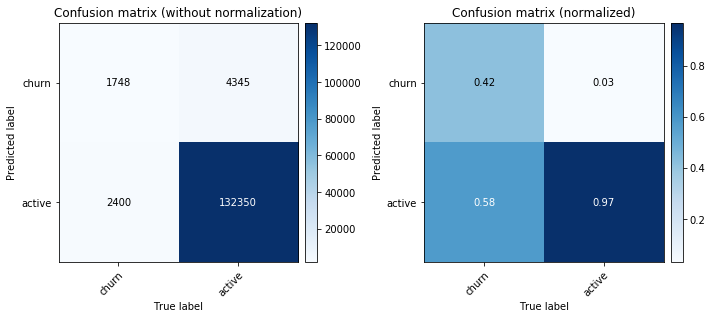

In [13]:
model = xgb_fit_predict(X_train_balanced, y_train_balanced, X_test, y_test)
predict_test = model.predict(X_test)
predict_test_probas = model.predict_proba(X_test)[:, 1]

plot_confusion_matrix(y_test.values, predict_test, classes=['churn', 'active'])
plt.show()

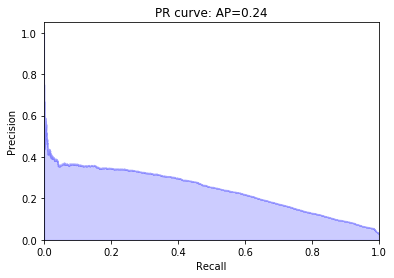

In [14]:
plot_PR_curve(y_test.values, predict_test, predict_test_probas)
plt.show()

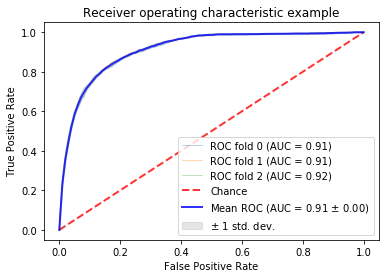

Wall time: 21.8 s


In [15]:
%%time
plot_ROC_curve(classifier=model, 
               X=X_test, 
               y=y_test.values, 
               n_folds=3)

#### 2. Обучите любые две другие модели для предсказания оттока для любом из отобранных множеств признаков и сравните качество с уже полученными.

In [10]:
from sklearn.neighbors import KNeighborsClassifier
KNC = KNeighborsClassifier(n_neighbors=4, leaf_size=17)
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=300, max_depth=12, random_state=42, max_features=3, min_samples_leaf=2, n_jobs=-1)                                                                                                                       

In [8]:
def evaluation_score(y_true, y_pred):
    precision = precision_score(y_true=y_true, y_pred=y_pred)
    recall = recall_score(y_true=y_true, y_pred=y_pred)
    f1 = f1_score(y_true=y_true, y_pred=y_pred)
    print('Precision: {}'.format(precision))
    print('Recall: {}'.format(recall))
    print('F1: {}'.format(f1))
    return precision, recall, f1

def model_fit_predict(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)
    predict_test = model.predict(X_test)
    precision_test, recall_test, f1_test = evaluation_score(y_test, predict_test)
    return model

In [27]:
%%time
fitted_knc = model_fit_predict(KNC, X_train_balanced, y_train_balanced, X_test, y_test)

Precision: 0.14609240723890404
Recall: 0.3483606557377049
F1: 0.20585511788588928
Wall time: 1h 34min 29s


In [28]:
%%time
fitted_knc_pi = model_fit_predict(KNC, X_train_PI, y_train_balanced, X_test_PI, y_test)

Precision: 0.15048543689320387
Recall: 0.35872709739633557
F1: 0.21202621829581073
Wall time: 32min 16s


In [11]:
%%time
fitted_rf = model_fit_predict(rf, X_train_balanced, y_train_balanced, X_test, y_test)

Precision: 0.2836116614774979
Recall: 0.4831243972999036
F1: 0.35741037988229
Wall time: 4min 37s


In [25]:
%%time
fitted_rf_pi = model_fit_predict(rf, X_train_PI, y_train_balanced, X_test_PI, y_test)

print('Признаков было:', X_train.shape[1])
print('Признаков стало:', X_train_PI.shape[1])

Precision: 0.2956076134699854
Recall: 0.48674059787849566
F1: 0.3678265622153398
Признаков было: 60
Признаков стало: 35
Wall time: 3min 46s


#### Вывод:  
Качество двух моделей по сравнению с уже полученными значениями, отличется не значительно.

#### 3. Постройте матрицу корреляций и предложите отбор признаков на основании этой матрицы.

In [4]:
df_for_corr = pd.DataFrame(X_train_balanced, columns=X.columns)

In [5]:
df_for_corr.head()

,level,donate_total,pay_amt_1,pay_amt_2,pay_amt_3,pay_amt_4,trans_amt_1,trans_amt_2,trans_amt_3,trans_amt_4,...,silver_spent_1,silver_spent_2,silver_spent_3,silver_spent_4,age,gender,days_between_reg_fl,days_between_fl_df,has_return_date,has_phone_number
0,0.275,0.001340,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.232877,0.0,0.000394,0.005589,1.0,1.0
1,0.350,0.001377,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.315068,0.0,0.000394,0.463115,1.0,1.0
2,0.300,0.003847,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000716,0.002884,0.001337,0.000000,0.260274,0.0,0.000394,0.000373,0.0,1.0
3,0.425,0.003994,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000146,0.001298,0.039584,0.018677,0.232877,0.0,0.000394,0.032042,1.0,1.0
4,0.025,0.000574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.007008,0.000000,0.000000,0.246575,0.0,0.000394,0.008197,1.0,1.0


In [9]:
%%time
%matplotlib inline
import seaborn as sns

plt.figure(figsize = (325,315))

sns.set(font_scale=10)
sns.heatmap(df_for_corr.corr().round(3), annot=True, linewidths=.5, cmap='GnBu')

plt.title('Correlation matrix')
plt.show()

Wall time: 1min 31s


Можем убрать один из признаков, которые сильно скоррелированы,т.к. у них линейнная зависимость.

#### 4. __(*)__ Как думаете, можно ли производить отбор признаков с помощью IV, а затем обучать модель случайного леса на отфильтрованном датасете? Ответ обоснуйте. 

Я думаю, что качество случайного леса будет хуже, т.к. IV создает линейную зависимость между признаками и слуйчайный лес может ее не увидеть.